In [1]:
!module load CUDA/10.2.89

In [2]:
import spacy
import pandas as pd
from bertviz import head_view, model_view
from transformers import BertTokenizer, BertModel


In [3]:
!which python

/gpfs/milgram/project/rtaylor/vs428/conda_envs/prodigy/bin/python


In [3]:
spacy.__version__

'3.2.3'

In [4]:
spacy.require_gpu()


True

# Create Misclassified Dataset

In [6]:
from spacy.tokens import DocBin
doc_bin = DocBin().from_disk("/home/vs428/project/Moore_data/followup_v3_data/dev.spacy")

In [10]:
docs = list(doc_bin.get_docs(nlp.vocab))

In [11]:
dev_doc_texts = [doc.text for doc in docs]

# Run Inference on Dev Set

In [16]:
nlp = spacy.load("/home/vs428/project/Moore_models/task_4_textcat_GOLD/model-best", exclude="tagger,parser,attribute_ruler,lemmatizer,ner")
nlp_orig = spacy.load("en_core_web_trf")
nlp.add_pipe("parser", source=nlp_orig, after="transformer")



In [14]:
# # taken from https://stackoverflow.com/a/44764557/1726404
# '''
# This works by using nlp.pipe and putting our records into tuples. We process it as tuples and get the context
# In our work, the context is just the study id. 
# We get the entity text, label, start and stop characters for each entity
# we convert that to a json string, we then put the [context,json] together into a list
# append this list to nlp_out
# then turn nlp out into a df with 1 col being study id and the other being the nlp out
# Finally we merge the df with our main data df. Now we have a column with the text
# '''
# import json
# nlp_out = []
# count = 0
# for doc, ctx in nlp.pipe(list(data_in[['CT_Text', 'KL_ID']].to_records(index=False)),
#                                     as_tuples=True, batch_size=50, n_process=1):
#     out_ = doc.cats
#     nlp_out.append([ctx, json.dumps(out_, indent = 2)])
#     print(count)
#     count +=1
# nlp_df = pd.DataFrame(nlp_out, columns=['KL_ID', 'NLP_OUT'])

In [18]:
cats = []

for doc in nlp.pipe(dev_doc_texts, disable=["tok2vec", "tagger", "parser", "attribute_ruler", "lemmatizer"]):
    cats.append(doc.cats)
    print(doc.cats)
    print([(ent.text, ent.label_) for ent in doc.ents])

{'NO_FOLLOWUP': 0.3891794681549072, 'HARD_FOLLOWUP': 0.31177496910095215, 'CONDITIONAL_FOLLOWUP': 0.29904553294181824}
[]
{'NO_FOLLOWUP': 0.4575633704662323, 'HARD_FOLLOWUP': 0.20533357560634613, 'CONDITIONAL_FOLLOWUP': 0.3371030390262604}
[]
{'NO_FOLLOWUP': 0.20102383196353912, 'HARD_FOLLOWUP': 0.24019597470760345, 'CONDITIONAL_FOLLOWUP': 0.5587801933288574}
[]
{'NO_FOLLOWUP': 0.39456209540367126, 'HARD_FOLLOWUP': 0.2898162007331848, 'CONDITIONAL_FOLLOWUP': 0.31562167406082153}
[]
{'NO_FOLLOWUP': 0.87382572889328, 'HARD_FOLLOWUP': 0.026704315096139908, 'CONDITIONAL_FOLLOWUP': 0.09946999698877335}
[]
{'NO_FOLLOWUP': 0.004533895291388035, 'HARD_FOLLOWUP': 0.07862395793199539, 'CONDITIONAL_FOLLOWUP': 0.9168421626091003}
[]
{'NO_FOLLOWUP': 0.25826311111450195, 'HARD_FOLLOWUP': 0.3876376152038574, 'CONDITIONAL_FOLLOWUP': 0.3540992736816406}
[]
{'NO_FOLLOWUP': 0.0041562700644135475, 'HARD_FOLLOWUP': 0.0877659022808075, 'CONDITIONAL_FOLLOWUP': 0.9080778360366821}
[]
{'NO_FOLLOWUP': 0.6478121

In [22]:
def extract_prodigy_vals(x):
    # tmp = eval(x)
    pred = max(tmp, key=tmp.get)
    score = tmp[pred]
    return pred, score




In [23]:
extract_prodigy_vals(cats)

NameError: name 'tmp' is not defined

In [30]:
misclassified = pd.read_csv("/home/vs428/Documents/Moore/cancer_spacy_data/misclassified_cts.csv")

In [31]:
print(misclassified[' TEXT'].tolist()[0])

CT CHEST WO IV CONTRAST   History: Fall tenderness over the right scapula.  History of non-small cell lung cancer status post left lower lobectomy.  COMPARISON: CT chest of 3/4/2015, and PET/CT of 9/18/2015  TECHNIQUE: Images were obtained of the chest without administration of intravenous contrast.  FINDINGS:  There is a minimally displaced fracture at the base of the right coracoid (41:4; 52:601). There are subacute displaced fractures of the right second and third anterior ribs. There is a likely acute minimally displaced right 10th rib fracture.  The patient is status post left lower lobectomy. Mild centrilobular emphysematous changes are again noted. A new pleural-based 5 mm nodular density is seen in the right lower lobe (image 191, series 4) and is nonspecific. Additional scattered sub-4 mm pulmonary nodules are overall stable.  Prominent left hilar lymph node, which was previously FDG avid in September 2015, is again noted although evaluation is limited due to the lack of intra

In [7]:
spacy.require_gpu()
nlp = spacy.load('/home/vs428/Documents/Moore/cancer_prodigy_train_dataset/model-best/',)
                 #exclude="attribute_ruler,lemmatizer,ner,parser,tagger")
# nlp_orig = spacy.load("en_core_web_trf")
# nlp.add_pipe("parser", source=nlp_orig, after="transformer")
# nlp.add_pipe("tagger", source=nlp_orig, after="parser")
# nlp.add_pipe("attribute_ruler", source=nlp_orig, after="tagger")
# nlp.add_pipe("lemmatizer", source=nlp_orig, after="attribute_ruler")
# nlp.add_pipe("ner", source=nlp_orig, after="lemmatizer")

In [9]:
# Load model and retrieve attention weights
# model_version = 'bert-base-uncased'
# model = BertModel.from_pretrained("/home/vs428/Documents/Moore/cancer_prodigy_train_dataset/model-best/transformer/model", output_attentions=True)
# tokenizer = BertTokenizer.from_pretrained("/home/vs428/Documents/Moore/cancer_prodigy_train_dataset/model-best/tokenizer")
nlp

In [ ]:
import spacy

nlp = spacy.blank("en")

# Construction via add_pipe with custom config
config = {
    "model": {
        "@architectures": "spacy-transformers.TransformerModel.v1",
        "name": "bert-base-uncased",
        "transformers_config": {"output_attentions": True},
        "get_spans" : {"@span_getters" : "spacy-transformers.strided_spans.v1",
                       "window" : 128,
                       "stride" : 96

                       
}
    }
}
transformer = nlp.add_pipe(
    "transformer", config=config)
transformer.model.initialize()


doc = nlp("This is a sentence.")

In [ ]:
# Construction via add_pipe with custom config
# config = {
#     "model": {
#         "@architectures": "spacy-transformers.TransformerModel.v3",
#         "name": "roberta-base",
#         "tokenizer_config": {"use_fast": True}
#     }
# }
# transformer = nlp.add_pipe(
#     "transformer", config=config)
# transformer.model.initialize()

doc = nlp("This is a sentence.")
doc._.trf_data.tensors[0].shape # (1, 7, 768) <-- wordpiece embedding
doc._.trf_data.tensors[1].shape  # (1, 768) <-- assuming this is the pooled embedding? At least I don't believe it is the attention as (maybe) suggested in the documentation

In [ ]:
len(doc._.trf_data.attention) # 12
doc._.trf_data.attention[-1].shape  # (1, 12, 7, 7) last layer of attention 
# len(doc._.trf_data.tensors) # 2 
# doc._.trf_data.tensors[0].shape # (1, 7, 768) <-- wordpiece embedding
# doc._.trf_data.tensors[1].shape  # (1, 768) <-- assuming this is the pooled embedding?

In [ ]:
doc._.trf_data

In [ ]:

def add_cfg(converter, config):
    """Wrap a conversion function, injecting the config into the 'args kwargs' object. The ArgsKwargs
    will be passed into the pytorch model as *ak.args, **ak.kwargs. So we want to update the kwargs.
    This function returns a function that acts as the converter.
    """
    def convert_with_cfg(model, X, is_train):
        Y, backprop = model(X, is_train)
        Y.kwargs.update(config)
        return Y, backprop
    return convert_with_cfg

In [ ]:
trf_component = nlp.get_pipe("transformer")
for node in trf_component.model.walk():
    if node.attrs.get("has_transformer"):
        print(node)
        # Here we're iterating over the model, to find the PyTorchWrapper layer that holds
        # the transformer. We're assuming that the transformer has already been loaded.
        # If it hasn't been loaded yet, we could replace the set_transformer function of the node instead.
        wrapper = node.layers[0]
        wrapper.attrs["convert_inputs"] = add_cfg(wrapper.attrs["convert_inputs"], {"output_attentions": True})



In [ ]:
doc = nlp("This is a sentence.")
# doc._.trf_data.tensors[0].shape # (1, 7, 768) <-- wordpiece embedding
# doc._.trf_data.tensors[1].shape  # (1, 768) <-- assuming this is the pooled embedding? At least I don't believe it is the attention as (maybe) suggested in the documentation

In [ ]:
sentence_a = "The cat sat on the mat"
sentence_b = "The cat lay on the rug"
inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt')
input_ids = inputs['input_ids']
token_type_ids = inputs['token_type_ids']
attention = model(input_ids, token_type_ids=token_type_ids)[-1]
sentence_b_start = token_type_ids[0].tolist().index(1)
input_id_list = input_ids[0].tolist() # Batch index 0
tokens = tokenizer.convert_ids_to_tokens(input_id_list) 

In [ ]:
head_view(attention, tokens, sentence_b_start)

# Using Shapley

In [5]:

import spacy 
import pandas as pd

In [6]:
misclassified = pd.read_csv("/home/vs428/Documents/Moore/cancer_spacy_data/misclassified_cts_impression.csv")

In [7]:
import shap

In [8]:
nlp = spacy.load('/home/vs428/Documents/Moore/followup_model_v3/model-best/', exclude="tagger,parser,attribute_ruler,lemmatizer,ner")


In [9]:
tokenizer_spacy = spacy.tokenizer.Tokenizer(nlp.vocab)
classes = list(nlp.get_pipe("textcat").labels)
# Define a function to predict
def predict(texts):
    # convert texts to bare strings
    texts = [str(text) for text in texts]
    results = []
    for doc in nlp.pipe(texts):
        # results.append([{'label': cat, 'score': doc.cats[cat]} for cat in doc.cats])
        results.append([doc.cats[cat] for cat in classes])
    return results

# Create a function to create a transformers-like tokenizer to match shap's expectations
def tok_wrapper(text, return_offsets_mapping=False):
    doc = tokenizer_spacy(text)
    out = {"input_ids": [tok.norm for tok in doc]}
    if return_offsets_mapping:
        out["offset_mapping"] = [(tok.idx, tok.idx + len(tok)) for tok in doc]
    return out

In [10]:
import shap
# Create the Shap Explainer
# - predict is the "model" function, adapted to a transformers-like model
# - masker is the masker used by shap, which relies on a transformers-like tokenizer
# - algorithm is set to permutation, which is the one used for transformers models
# - output_names are the classes (although it is not propagated to the permutation explainer currently, which is why plots do not have the labels)
# - max_evals is set to a high number to reduce the probability of cases where the explainer fails because there are too many tokens
explainer = shap.Explainer(
    predict,
    masker=shap.maskers.Text(tok_wrapper),
    algorithm="permutation",
    output_names=classes,
    max_evals=1500,
)

In [11]:
bad_misses = misclassified[(misclassified["y_pred"] == "NO_FOLLOWUP") & (misclassified["y_true"] == "HARD_FOLLOWUP")]

In [16]:
# shap_values = explainer(misclassified[' TEXT'].tolist()[:2])
shap_values = explainer(bad_misses['TEXT'].tolist())
shap_values.output_names = classes

Permutation explainer: 8it [01:07, 11.27s/it]                       


In [17]:
shap.plots.text(shap_values)

In [18]:
shap.plots.text(shap_values[:, :, "HARD_FOLLOWUP"])

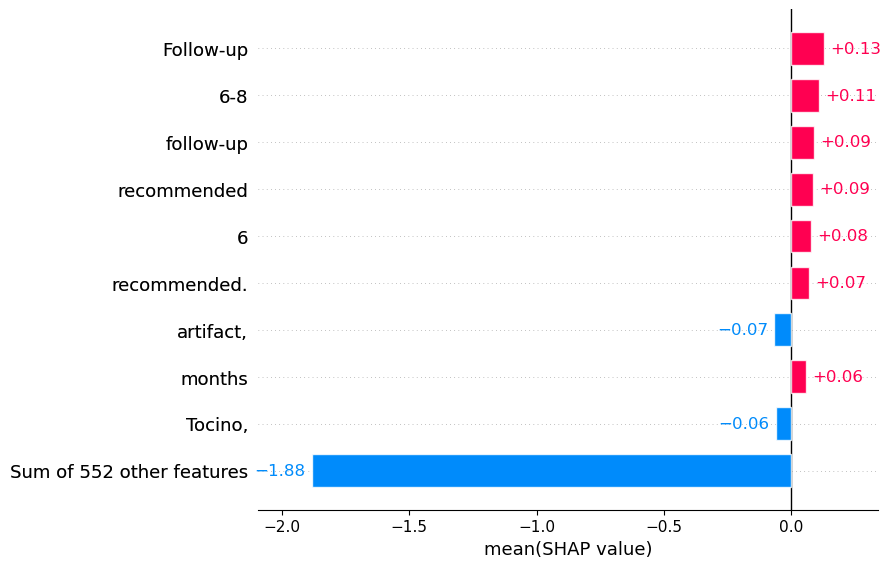

In [19]:
shap.plots.bar(shap_values[:,:,"HARD_FOLLOWUP"].mean(0))